# Pix2Pix GAN for Image-to-Image Translation

## Initialization

In [1]:
# Install required libraries
!pip install -q torch_snippets torch_summary

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.8/79.8 kB 2.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 6.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.5/62.5 kB 5.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.6/78.6 kB 7.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 204.2/204.2 kB 9.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.9/3.9 MB 12.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 30.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.9/98.9 kB 7.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.8/3.8 MB 38.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 30.8/30.8 MB 34.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 177.4/177.4 kB 9.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.4/3.4 MB 14.5 MB/s eta 0:00

In [2]:
# Import libraries
import os
import numpy as np

import torch
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from torch import nn, optim
from torchvision import transforms as T
from torchsummary import summary
from torch_snippets import *

from sklearn.model_selection import train_test_split

import cv2

print(f"PyTorch Version: {torch.__version__}")
!nvidia-smi # check if GPU is available
%matplotlib inline

PyTorch Version: 2.2.1+cu121

Tue Apr  9 00:17:16 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   54C    P8              10W /  70W |      3MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [3]:
# Set device to GPU if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Running on:", device)

Running on: cuda

In [4]:
# Download and extract the dataset
if not os.path.exists('ShoeV2_photo'):
    !wget https://www.dropbox.com/s/g6b6gtvmdu0h77x/ShoeV2_photo.zip
    !unzip -q ShoeV2_photo.zip

--2024-04-09 00:17:17--  https://www.dropbox.com/s/g6b6gtvmdu0h77x/ShoeV2_photo.zip
Resolving www.dropbox.com (www.dropbox.com)... 162.125.65.18, 2620:100:6017:18::a27d:212
Connecting to www.dropbox.com (www.dropbox.com)|162.125.65.18|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: /s/raw/g6b6gtvmdu0h77x/ShoeV2_photo.zip [following]
--2024-04-09 00:17:18--  https://www.dropbox.com/s/raw/g6b6gtvmdu0h77x/ShoeV2_photo.zip
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://ucdad74bae940fd91d43609953f5.dl.dropboxusercontent.com/cd/0/inline/CQpypiuoIduV--YLSf9RqQ3WdHLrYmjqgwj6NEGbYW_kdgx0qh3Mp4a5mqm9qnTzf8BvEC1_Y2mByKVeTcT25LhSs3SUi46o8oqwgKzkNS-5QUglHen8AHYlpfdi3UARURh3gEcpsfyPcELzWN2X5OjD/file# [following]
--2024-04-09 00:17:19--  https://ucdad74bae940fd91d43609953f5.dl.dropboxusercontent.com/cd/0/inline/CQpypiuoIduV--YLSf9RqQ3WdHLrYmjqgwj6NEGbYW_kdgx0qh3Mp4a5mqm9qnTzf8BvEC1_Y2mByKVeTcT25LhS

In [5]:
# Create a function to detect edges in an image
def detect_edges(image):
    gray_image = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY) # Convert to grayscale
    clean_gray_image = cv2.bilateralFilter(gray_image, 5, 50, 50) # Edge preserving noise reduction
    clean_gray_image_edges = cv2.Canny(clean_gray_image, 45, 100) # Detect edges
    inverted_clean_gray_image_edges = cv2.bitwise_not(clean_gray_image_edges) # Invert black/white
    return cv2.cvtColor(inverted_clean_gray_image_edges, cv2.COLOR_GRAY2RGB) # Return as RGB

In [6]:
# Create a preprocessing pipeline
preprocess = T.Compose([
    T.Lambda(lambda x: torch.Tensor(x.copy()).permute(2, 0, 1).to(device))
])

normalize = lambda x: (x - 127.5)/127.5 # Normalize to [-1, 1]

# Create a denormalization pipeline
denormalize = T.Normalize((-1, -1, -1), (2, 2, 2)) # Denormalize to [0, 1]

# Set the image size for the model
IMAGE_SIZE = 256

In [7]:
# Create Dataset class to fetch images and their edges
class ShoesData(Dataset):
    def __init__(self, items):
        self.items = items

    def __len__(self):
        return len(self.items)

    def __getitem__(self, idx):
        file = self.items[idx]
        try: image = read(file, 1)
        except:
            blank = preprocess(Blank(IMAGE_SIZE, IMAGE_SIZE, 3)).to(device)
            return blank, blank
        edges = detect_edges(image)
        image, edges = resize(image, IMAGE_SIZE), resize(edges, IMAGE_SIZE)
        image, edges = normalize(image), normalize(edges)
        self._draw_color_circles_on_src_img(edges, image)
        image, edges = preprocess(image).to(device), preprocess(edges).to(device)
        return edges, image

    def _draw_color_circles_on_src_img(self, src_image, target_image):
        non_white_coords = self._get_non_white_coordinates(target_image)
        for center_y, center_x in non_white_coords:
            self._draw_color_circle_on_src_img(src_image, target_image, center_y, center_x)

    def _get_non_white_coordinates(self, image):
        non_white_mask = np.sum(image, axis=-1) < 2.75
        non_white_y, non_white_x = np.nonzero(non_white_mask)
        n_non_white = len(non_white_y)
        n_color_points = min(n_non_white, 300)
        idxs = np.random.choice(n_non_white, n_color_points, replace=False) # Randomly sample non-white coordinates
        return list(zip(non_white_y[idxs], non_white_x[idxs])) # Return (y, x) coordinates

    def _draw_color_circle_on_src_img(self, src_image, target_image, center_y, center_x):
        assert src_image.shape == target_image.shape, "Image source and target must have same shape."
        y0, y1, x0, x1 = self._get_color_point_bbox_coords(center_y, center_x)
        color = np.mean(target_image[y0:y1, x0:x1], axis=(0, 1))
        src_image[y0:y1, x0:x1] = color

    def _get_color_point_bbox_coords(self, center_y, center_x):
        radius = 2
        y0 = max(0, center_y-radius+1)
        y1 = min(IMAGE_SIZE, center_y+radius)
        x0 = max(0, center_x-radius+1)
        x1 = min(IMAGE_SIZE, center_x+radius)
        return y0, y1, x0, x1

    def choose(self):
        return self[randint(len(self))]

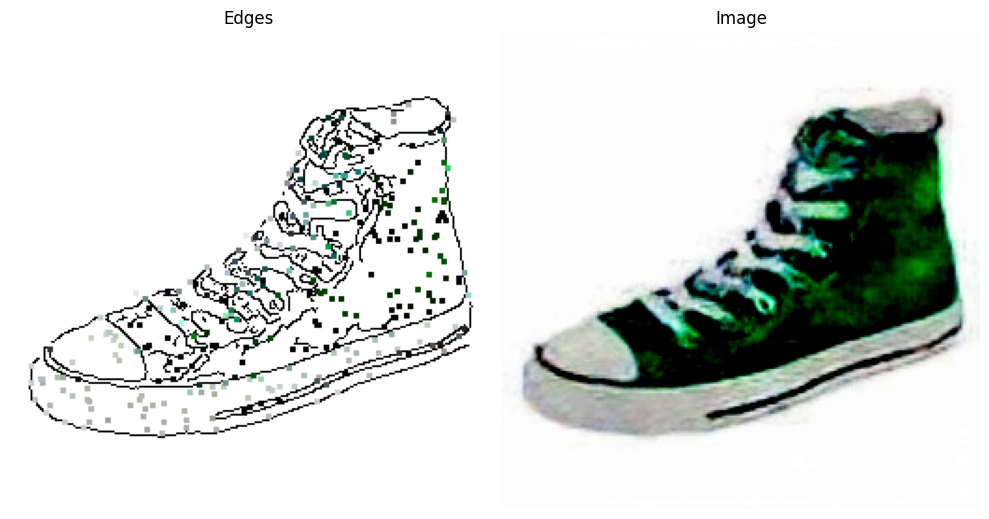

In [64]:
# Create train and validation datasets
train_items, val_items = train_test_split(Glob('ShoeV2_photo/*.png'), test_size=0.2, random_state=4)
train_ds, val_ds = ShoesData(train_items), ShoesData(val_items)

# Create a function to retrieve the dataloaders
def load_data(batch_size = 32):
    train_dl = DataLoader(train_ds, batch_size=batch_size, shuffle=True)
    val_dl = DataLoader(val_ds, batch_size=1, shuffle=True)
    return train_dl, val_dl

# Plot a sample image from the dataloader
train_dl, val_dl = load_data()
edges, image = next(iter(train_dl))
subplots([edges[0].permute(1, 2, 0).cpu().numpy(), image[0].permute(1, 2, 0).cpu().numpy()], nc=2, titles=['Edges', 'Image'], sz=10)

In [65]:
# Create a function to initialize weights so they have less spread
def weights_init_normal(model):
    classname = model.__class__.__name__
    if classname.find("Conv") != -1:
        nn.init.normal_(model.weight.data, 0.0, 0.02)
    elif classname.find("BatchNorm2d") != -1:
        nn.init.normal_(model.weight.data, 1.0, 0.02)
        nn.init.constant_(model.bias.data, 0.0)

In [66]:
# Create a class for the UNet Downsampling block
class UNetDown(nn.Module):
    def __init__(self, in_size, out_size, normalize=True, dropout=0.0):
        super().__init__()
        layers = [nn.Conv2d(in_size, out_size, 4, 2, 1, bias=False)]
        if normalize:
            layers.append(nn.InstanceNorm2d(out_size))
        layers.append(nn.LeakyReLU(0.2))
        if dropout:
            layers.append(nn.Dropout(dropout))
        self.model = nn.Sequential(*layers)

    def forward(self, x):
        return self.model(x)

# Create a class for the UNet Upsampling block
class UNetUp(nn.Module):
    def __init__(self, in_size, out_size, dropout=0.0):
        super().__init__()
        layers = [
            nn.ConvTranspose2d(in_size, out_size, 4, 2, 1, bias=False),
            nn.InstanceNorm2d(out_size),
            nn.ReLU(inplace=True),
        ]
        if dropout:
            layers.append(nn.Dropout(dropout))

        self.model = nn.Sequential(*layers)

    def forward(self, x, skip_input):
        x = self.model(x)
        return torch.cat((x, skip_input), 1)

# Create a class for the UNet Generator model
class GeneratorUNet(nn.Module):
    def __init__(self, in_channels=3, out_channels=3):
        super().__init__()
        self.down1 = UNetDown(in_channels, 64, normalize=False)
        self.down2 = UNetDown(64, 128)
        self.down3 = UNetDown(128, 256)
        self.down4 = UNetDown(256, 512, dropout=0.5)
        self.down5 = UNetDown(512, 512, dropout=0.5)
        self.down6 = UNetDown(512, 512, dropout=0.5)
        self.down7 = UNetDown(512, 512, dropout=0.5)
        self.down8 = UNetDown(512, 512, normalize=False, dropout=0.5)

        self.up1 = UNetUp(512, 512, dropout=0.5)
        self.up2 = UNetUp(1024, 512, dropout=0.5)
        self.up3 = UNetUp(1024, 512, dropout=0.5)
        self.up4 = UNetUp(1024, 512, dropout=0.5)
        self.up5 = UNetUp(1024, 256)
        self.up6 = UNetUp(512, 128)
        self.up7 = UNetUp(256, 64)

        self.final = nn.Sequential(
            nn.Upsample(scale_factor=2),
            nn.ZeroPad2d((1, 0, 1, 0)),
            nn.Conv2d(128, out_channels, 4, padding=1),
            nn.Tanh(),
        )

    def forward(self, x):
        d1 = self.down1(x)
        d2 = self.down2(d1)
        d3 = self.down3(d2)
        d4 = self.down4(d3)
        d5 = self.down5(d4)
        d6 = self.down6(d5)
        d7 = self.down7(d6)
        d8 = self.down8(d7)
        u1 = self.up1(d8, d7)
        u2 = self.up2(u1, d6)
        u3 = self.up3(u2, d5)
        u4 = self.up4(u3, d4)
        u5 = self.up5(u4, d3)
        u6 = self.up6(u5, d2)
        u7 = self.up7(u6, d1)
        return self.final(u7)

# Create a class for the Discriminator model
class Discriminator(nn.Module):
    def __init__(self, in_channels=3):
        super().__init__()

        def discriminator_block(in_filters, out_filters, normalization=True):
            layers = [nn.Conv2d(in_filters, out_filters, 4, stride=2, padding=1)]
            if normalization:
                layers.append(nn.InstanceNorm2d(out_filters))
            layers.append(nn.LeakyReLU(0.2, inplace=True))
            return layers

        self.model = nn.Sequential(
            *discriminator_block(in_channels * 2, 64, normalization=False),
            *discriminator_block(64, 128),
            *discriminator_block(128, 256),
            *discriminator_block(256, 512),
            nn.ZeroPad2d((1, 0, 1, 0)),
            nn.Conv2d(512, 1, 4, padding=1, bias=False)
        )

    def forward(self, image_a, image_b):
        input_image = torch.cat((image_a, image_b), 1)
        return self.model(input_image)

In [67]:
# Create a mock-up Discriminator model and print summary
discriminator = Discriminator().to(device)
summary(discriminator, [(3, IMAGE_SIZE, IMAGE_SIZE), (3, IMAGE_SIZE, IMAGE_SIZE)])

# Create a mock-up Generator model and print summary
generator = GeneratorUNet().to(device)
summary(generator, (3, IMAGE_SIZE, IMAGE_SIZE))

Layer (type:depth-idx)                   Output Shape              Param #
├─Sequential: 1-1                        [-1, 1, 16, 16]           --
|    └─Conv2d: 2-1                       [-1, 64, 128, 128]        6,208
|    └─LeakyReLU: 2-2                    [-1, 64, 128, 128]        --
|    └─Conv2d: 2-3                       [-1, 128, 64, 64]         131,200
|    └─InstanceNorm2d: 2-4               [-1, 128, 64, 64]         --
|    └─LeakyReLU: 2-5                    [-1, 128, 64, 64]         --
|    └─Conv2d: 2-6                       [-1, 256, 32, 32]         524,544
|    └─InstanceNorm2d: 2-7               [-1, 256, 32, 32]         --
|    └─LeakyReLU: 2-8                    [-1, 256, 32, 32]         --
|    └─Conv2d: 2-9                       [-1, 512, 16, 16]         2,097,664
|    └─InstanceNorm2d: 2-10              [-1, 512, 16, 16]         --
|    └─LeakyReLU: 2-11                   [-1, 512, 16, 16]         --
|    └─ZeroPad2d: 2-12                   [-1, 512, 17, 17]       

Layer (type:depth-idx)                   Output Shape              Param #
├─UNetDown: 1-1                          [-1, 64, 128, 128]        --
|    └─Sequential: 2-1                   [-1, 64, 128, 128]        --
|    |    └─Conv2d: 3-1                  [-1, 64, 128, 128]        3,072
|    |    └─LeakyReLU: 3-2               [-1, 64, 128, 128]        --
├─UNetDown: 1-2                          [-1, 128, 64, 64]         --
|    └─Sequential: 2-2                   [-1, 128, 64, 64]         --
|    |    └─Conv2d: 3-3                  [-1, 128, 64, 64]         131,072
|    |    └─InstanceNorm2d: 3-4          [-1, 128, 64, 64]         --
|    |    └─LeakyReLU: 3-5               [-1, 128, 64, 64]         --
├─UNetDown: 1-3                          [-1, 256, 32, 32]         --
|    └─Sequential: 2-3                   [-1, 256, 32, 32]         --
|    |    └─Conv2d: 3-6                  [-1, 256, 32, 32]         524,288
|    |    └─InstanceNorm2d: 3-7          [-1, 256, 32, 32]         --
| 

In [68]:
# Create a function to train the Discriminator
def train_discriminator(model, data, criterion, optimizer):
    model.train()
    optimizer.zero_grad()
    real_src, real_target, fake_target = data
    prediction_real = model(real_target, real_src)
    error_real = criterion(prediction_real, torch.ones(len(real_src), 1, 16, 16).cuda())
    error_real.backward()
    prediction_fake = model(fake_target.detach(), real_src)
    error_fake = criterion(prediction_fake, torch.zeros(len(real_src), 1, 16, 16).cuda())
    error_fake.backward()
    optimizer.step()
    return error_real + error_fake

# Create a function to train the Generator
def train_generator(model, data, criterions, optimizer, lambda_pixel=100):
    model.train()
    optimizer.zero_grad()
    real_src, real_target, fake_target = data
    criterion_GAN, criterion_pixelwise = criterions
    prediction = model(fake_target, real_src) # Discriminator prediction
    loss_GAN = criterion_GAN(prediction, torch.ones(len(real_src), 1, 16, 16).cuda())
    loss_pixelwise = criterion_pixelwise(fake_target, real_target)
    error = loss_GAN + (lambda_pixel * loss_pixelwise)
    error.backward()
    optimizer.step()
    return error

In [69]:
# Create a function to save a generated image from the validation set
def sample_prediction(dataloader, generator):
    data = next(iter(dataloader))
    real_src, real_target = data
    fake_target = generator(real_src)
    subplots(
        [
            denormalize(real_src[0]).permute(1, 2, 0).cpu().numpy(),
            denormalize(fake_target[0]),
            denormalize(real_target[0])
        ], nc=3, titles=['Source', 'Generated', 'Ground Truth'], sz=12)

EPOCH: 1.000  d_loss: 1.218  g_loss: 19.873  (158.36s - 4592.37s remaining)


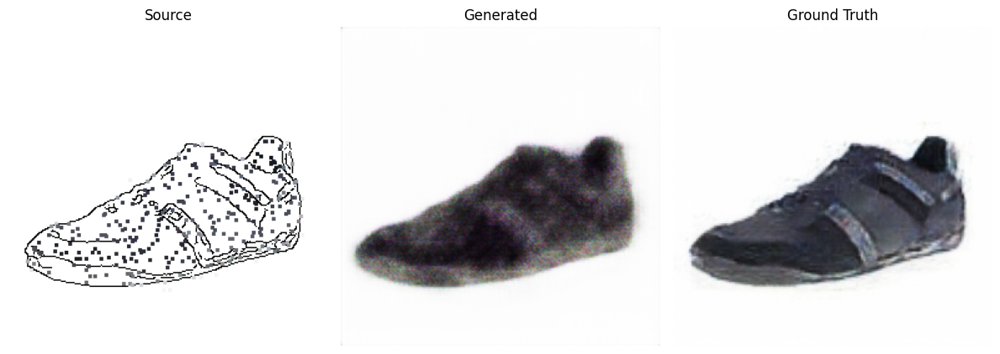

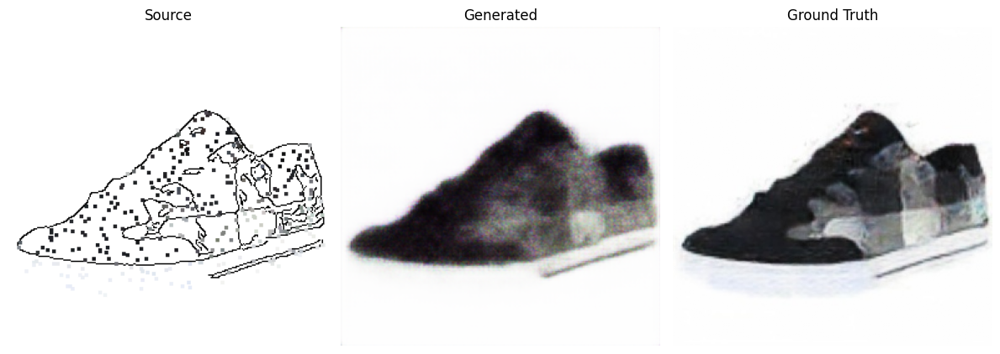

EPOCH: 2.000  d_loss: 0.535  g_loss: 10.771  (317.18s - 4440.58s remaining)


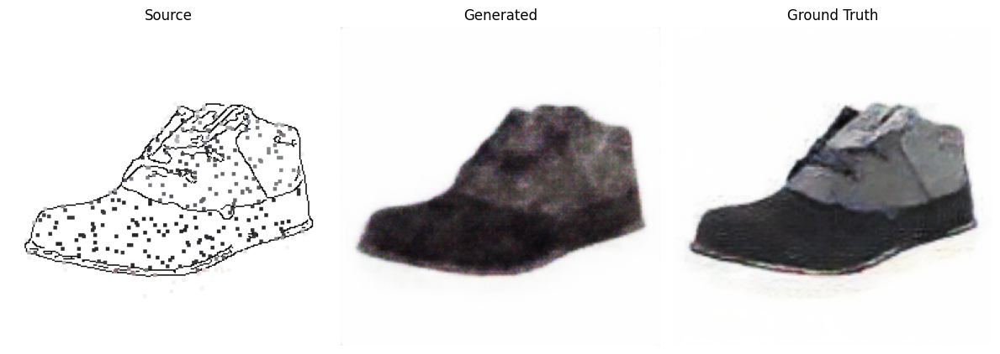

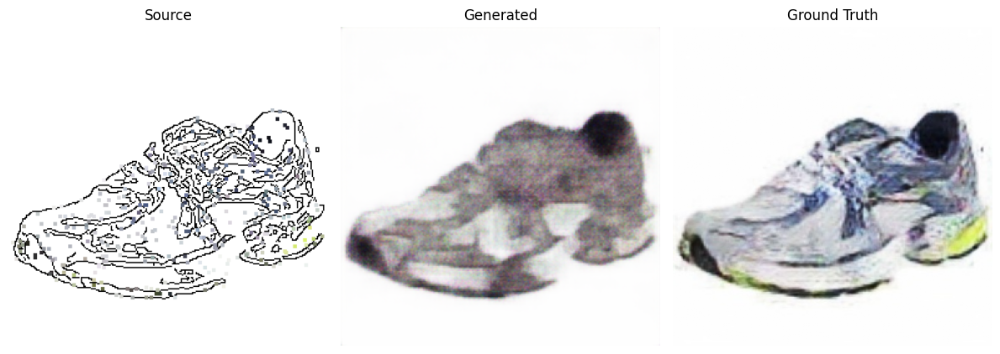

EPOCH: 3.000  d_loss: 0.519  g_loss: 8.651  (477.05s - 4293.49s remaining)


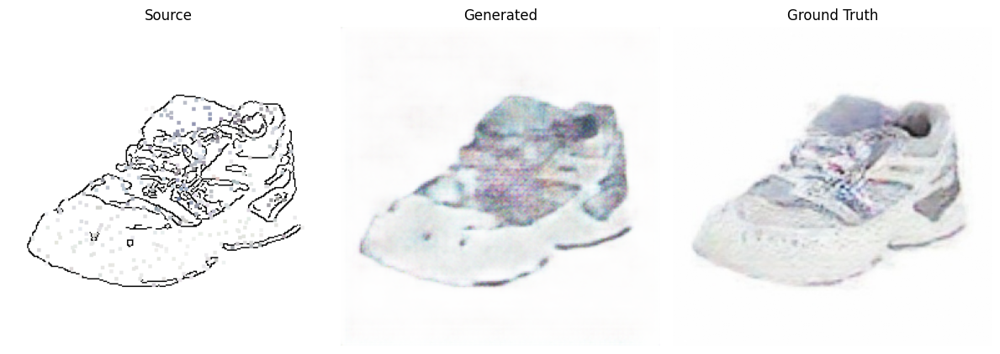

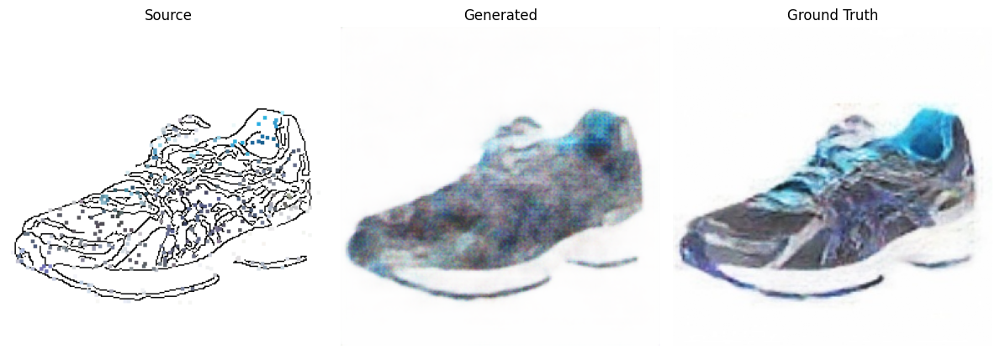

EPOCH: 4.000  d_loss: 0.523  g_loss: 7.400  (637.85s - 4146.02s remaining)


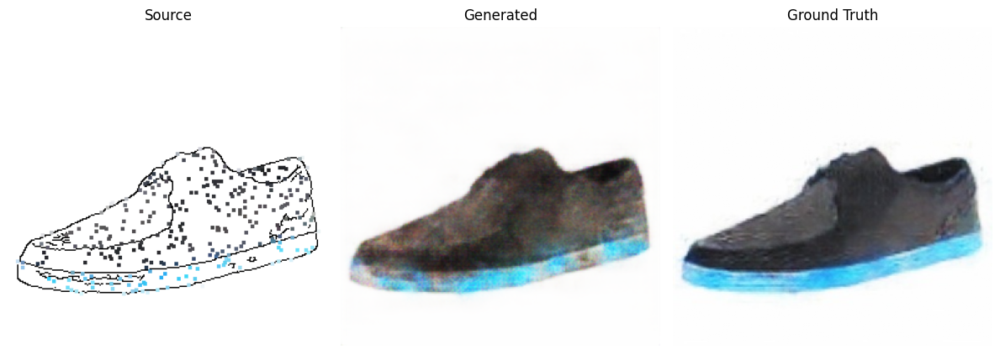

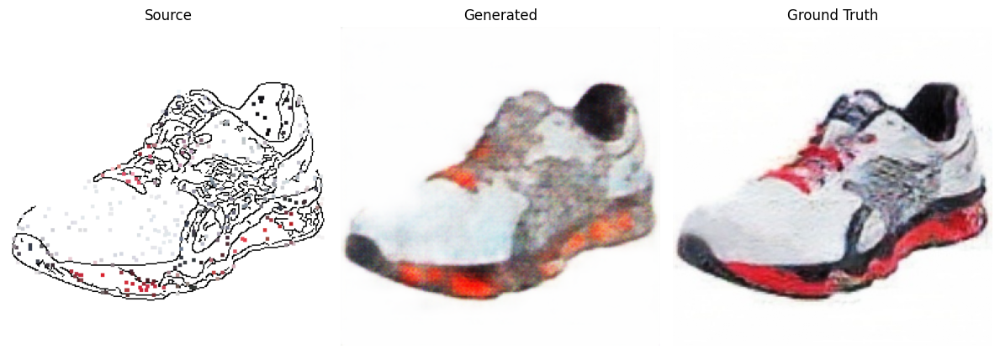

EPOCH: 5.000  d_loss: 0.515  g_loss: 6.670  (799.05s - 3995.27s remaining)


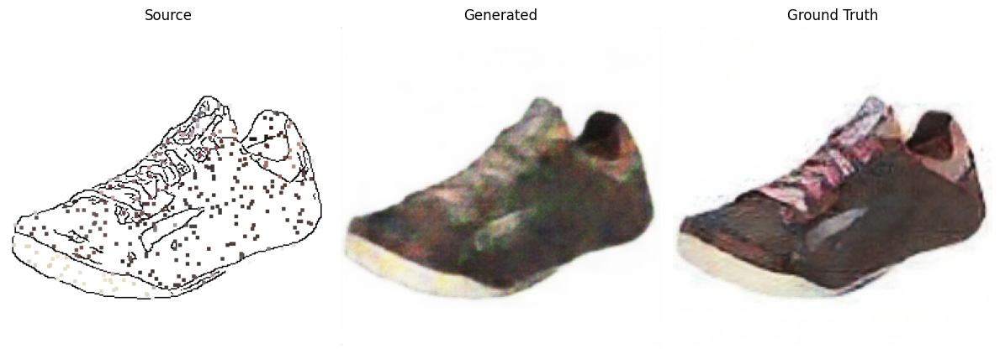

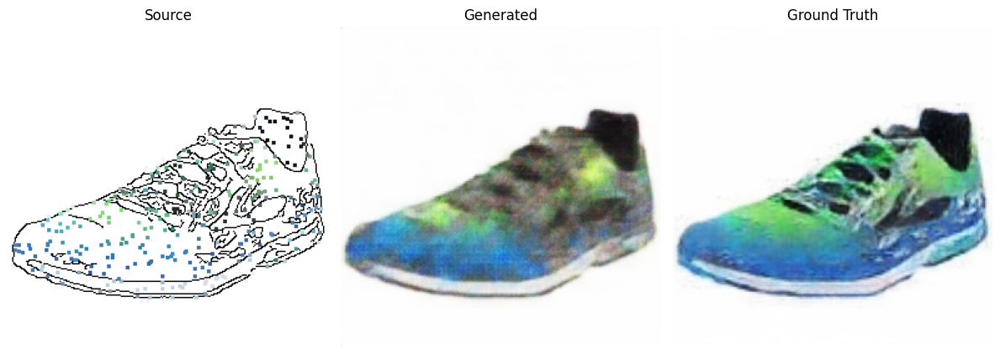

EPOCH: 6.000  d_loss: 0.544  g_loss: 6.217  (960.40s - 3841.60s remaining)


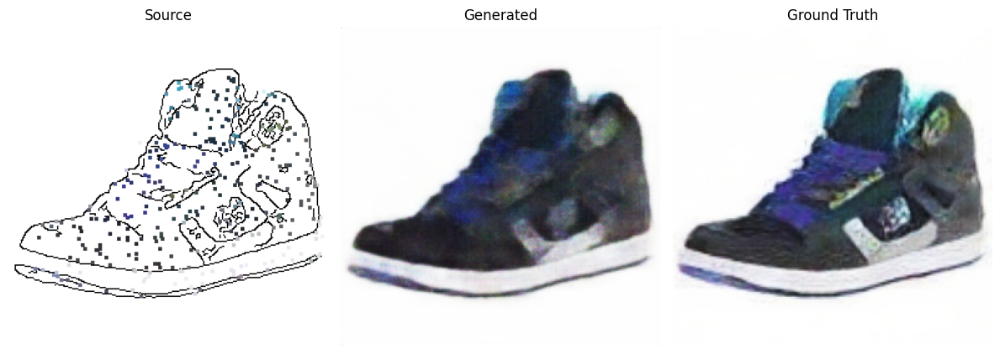

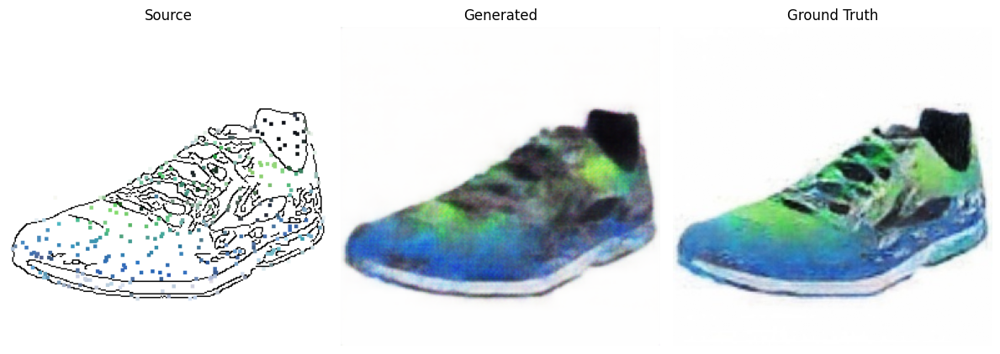

EPOCH: 7.000  d_loss: 0.498  g_loss: 5.796  (1121.19s - 3683.92s remaining)


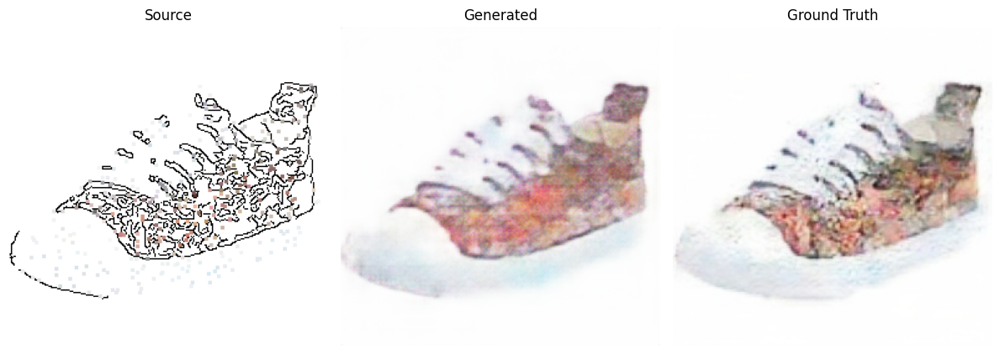

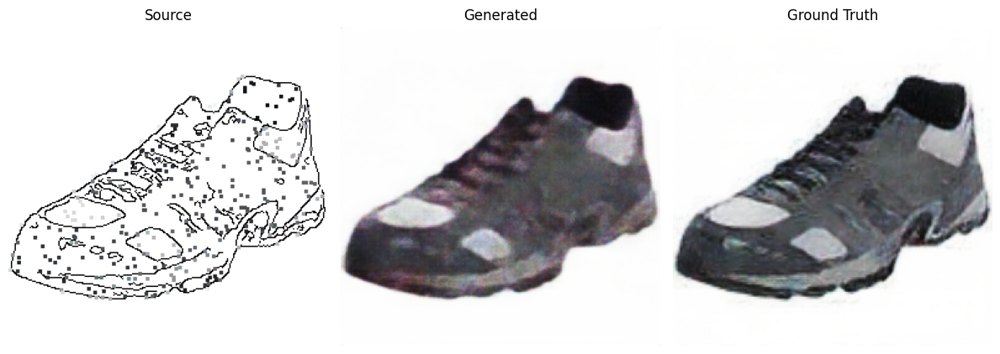

EPOCH: 8.000  d_loss: 0.492  g_loss: 5.567  (1282.92s - 3528.03s remaining)


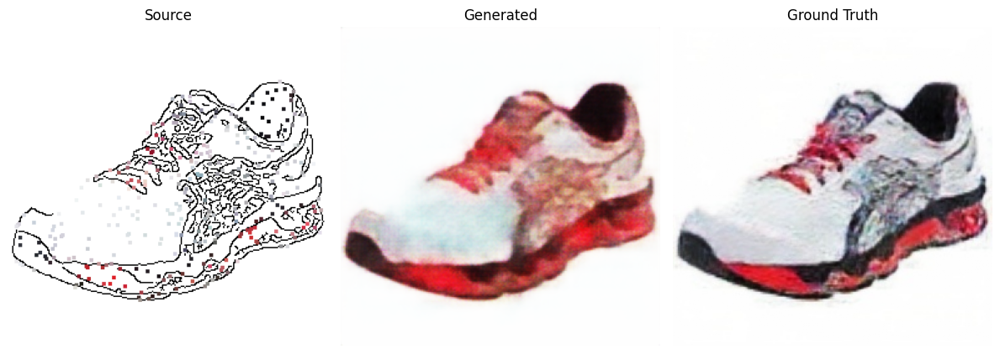

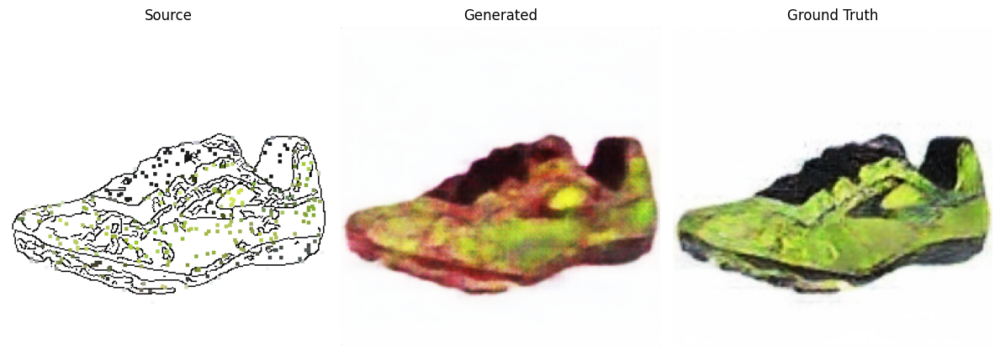

EPOCH: 9.000  d_loss: 0.513  g_loss: 5.334  (1444.73s - 3371.04s remaining)


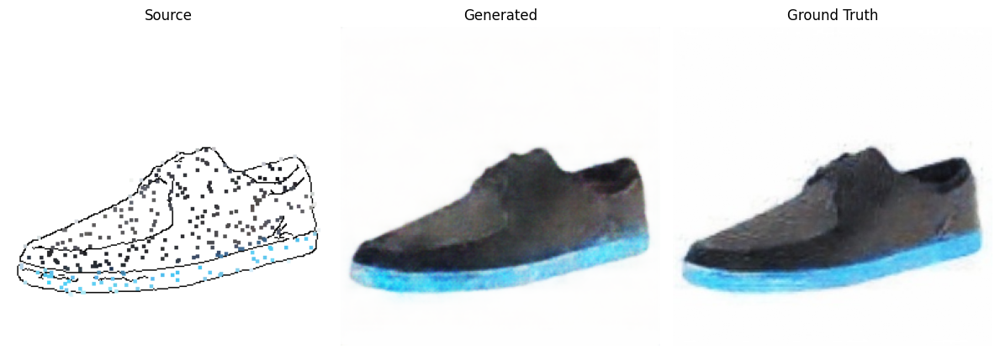

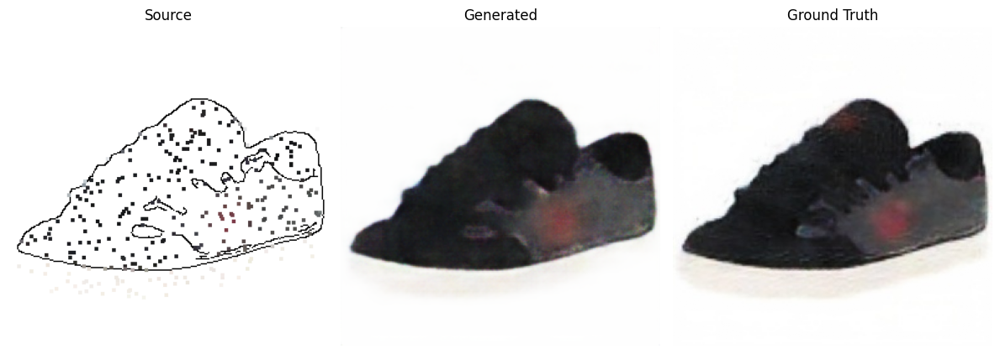

EPOCH: 10.000  d_loss: 0.477  g_loss: 5.075  (1606.96s - 3213.92s remaining)


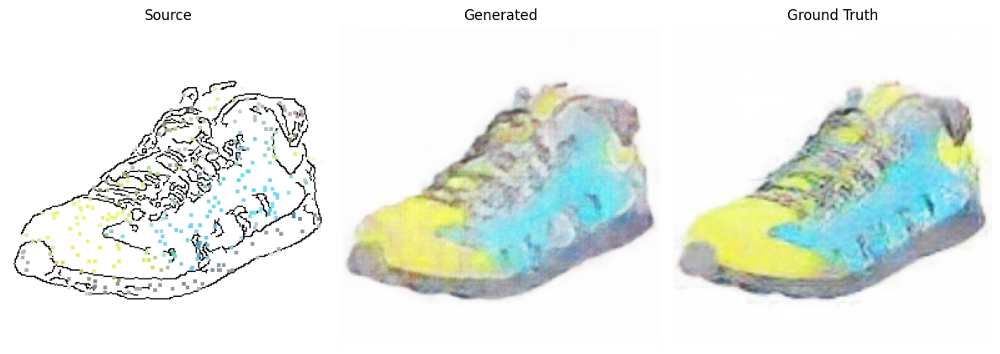

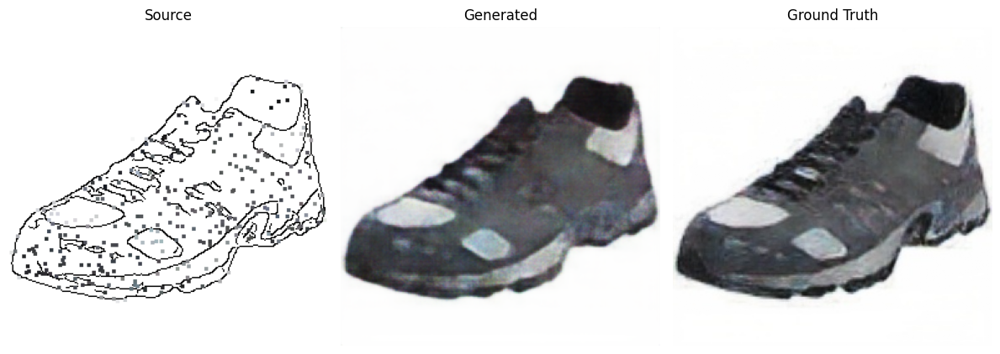

EPOCH: 11.000  d_loss: 0.477  g_loss: 4.910  (1769.10s - 3055.72s remaining)


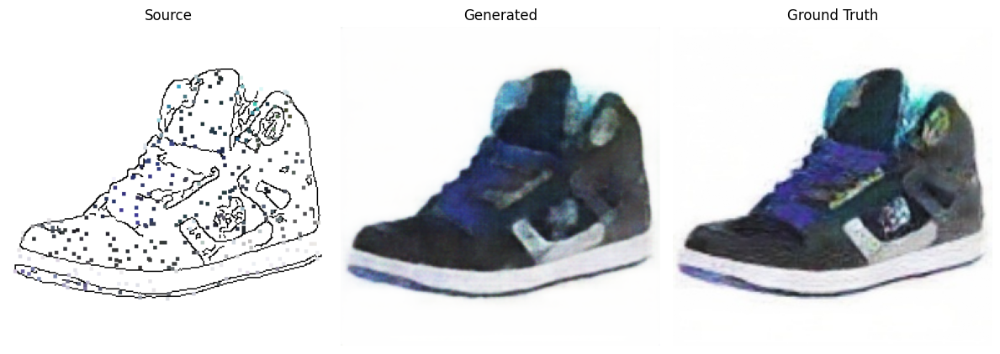

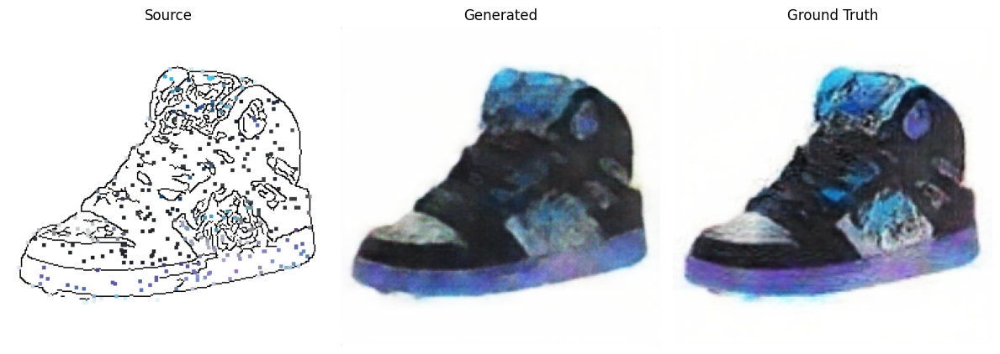

EPOCH: 12.000  d_loss: 0.499  g_loss: 4.804  (1931.81s - 2897.71s remaining)


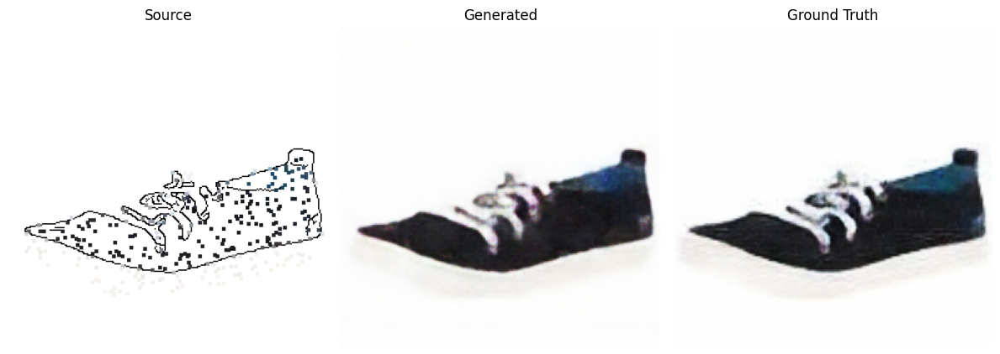

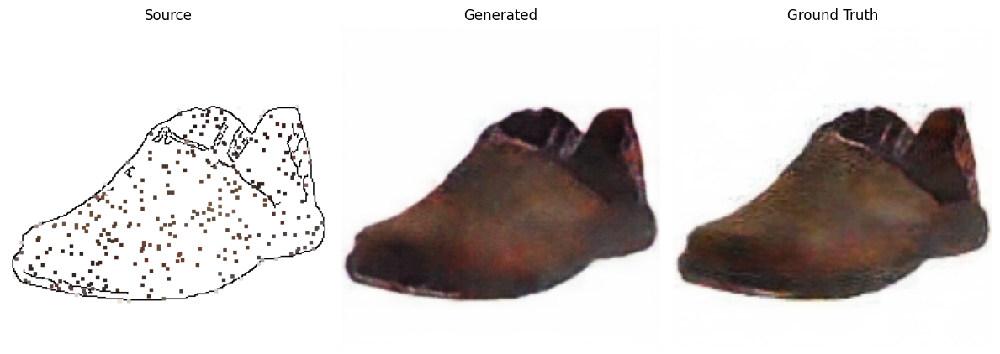

EPOCH: 13.000  d_loss: 0.472  g_loss: 4.604  (2094.55s - 2739.02s remaining)


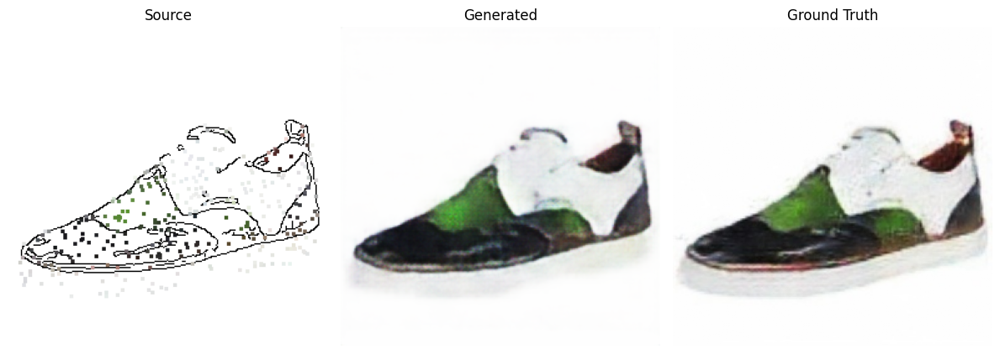

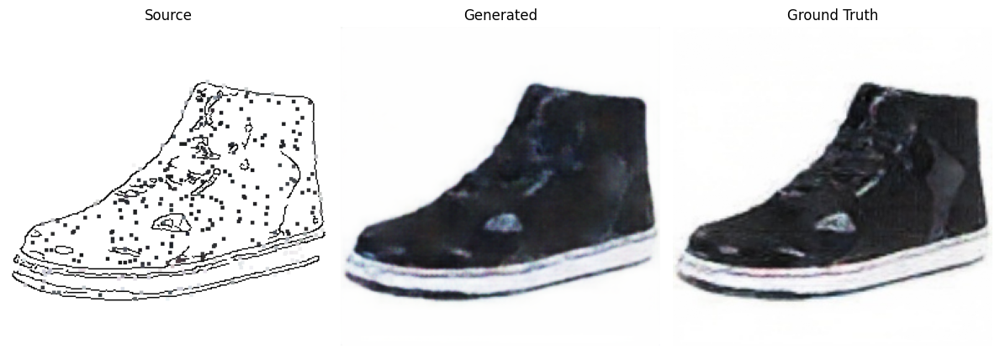

EPOCH: 14.000  d_loss: 0.506  g_loss: 4.550  (2258.50s - 2581.14s remaining)


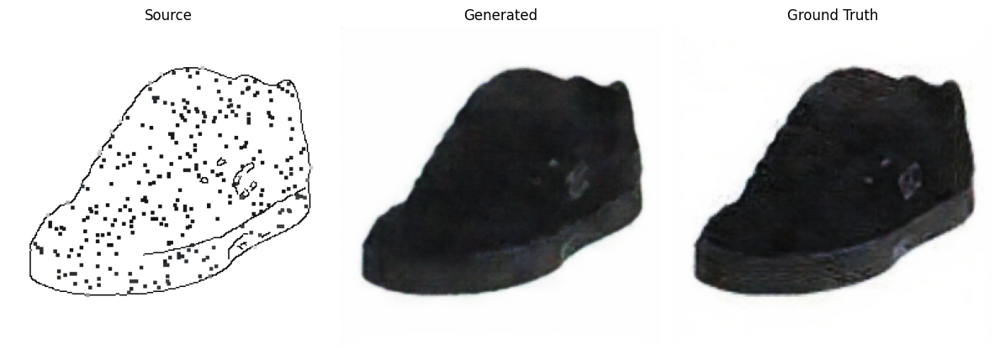

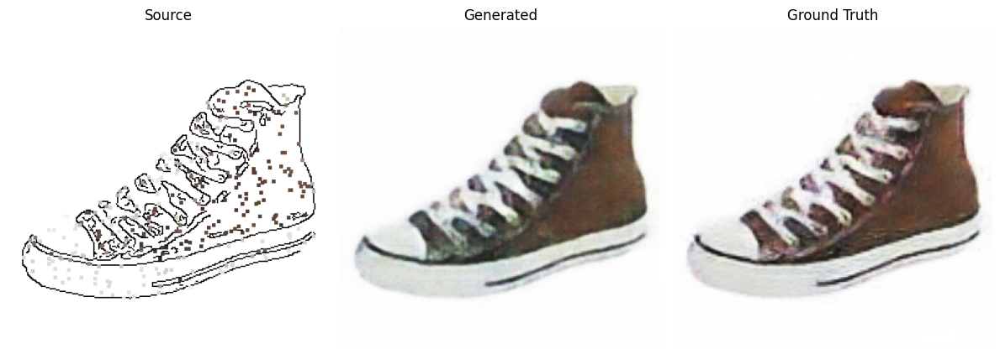

EPOCH: 15.000  d_loss: 0.492  g_loss: 4.371  (2422.34s - 2422.34s remaining)


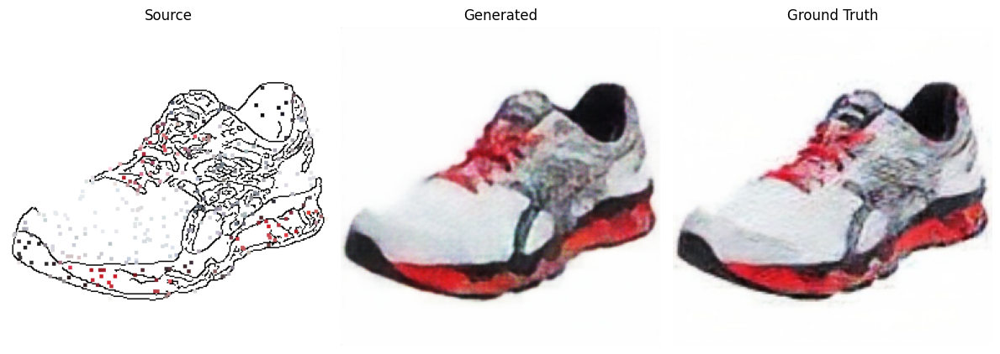

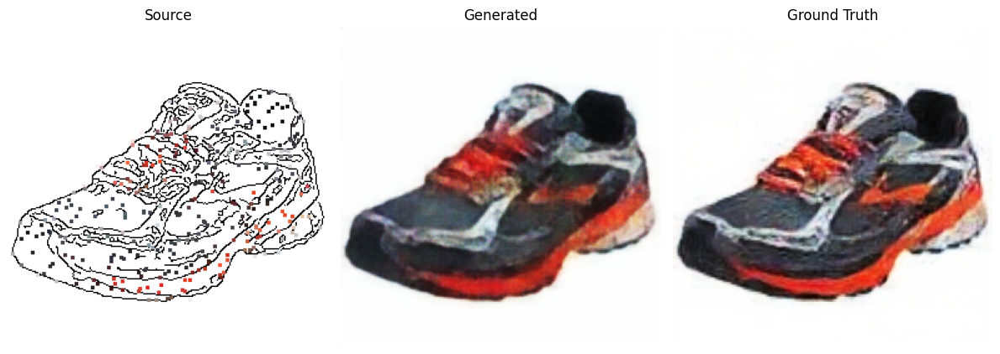

EPOCH: 16.000  d_loss: 0.495  g_loss: 4.275  (2586.83s - 2263.48s remaining)


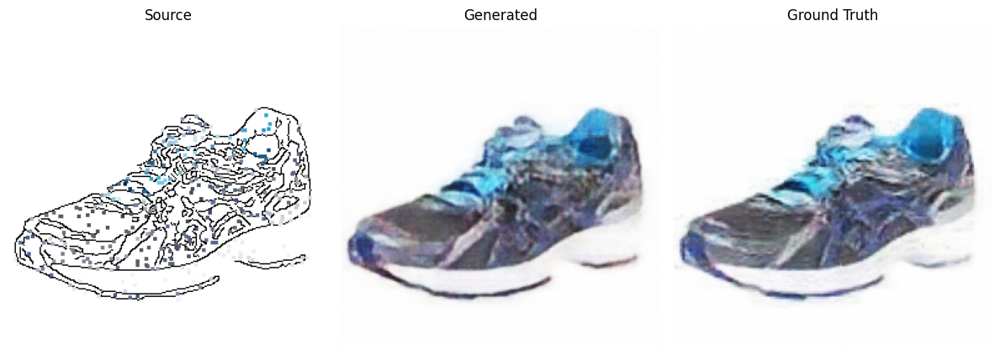

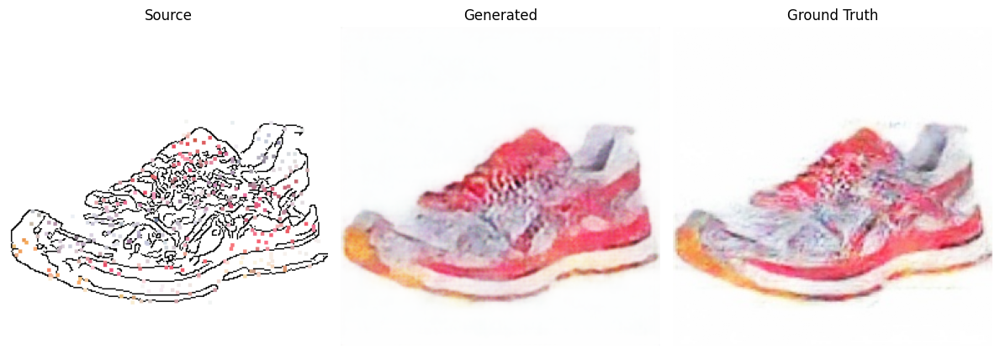

EPOCH: 17.000  d_loss: 0.512  g_loss: 4.201  (2750.94s - 2103.66s remaining)


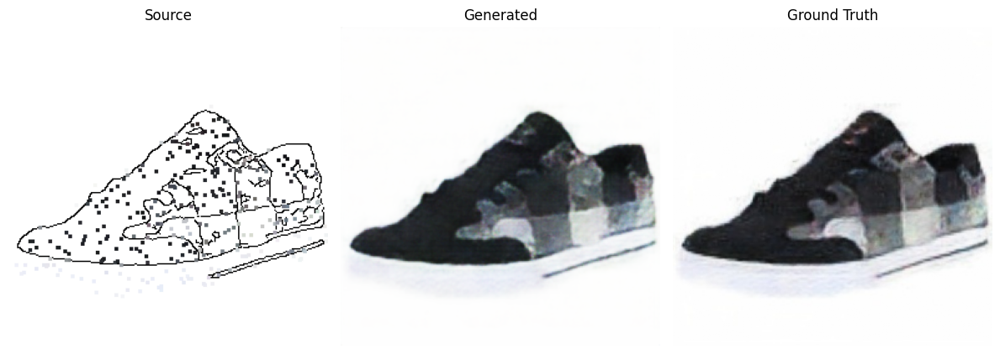

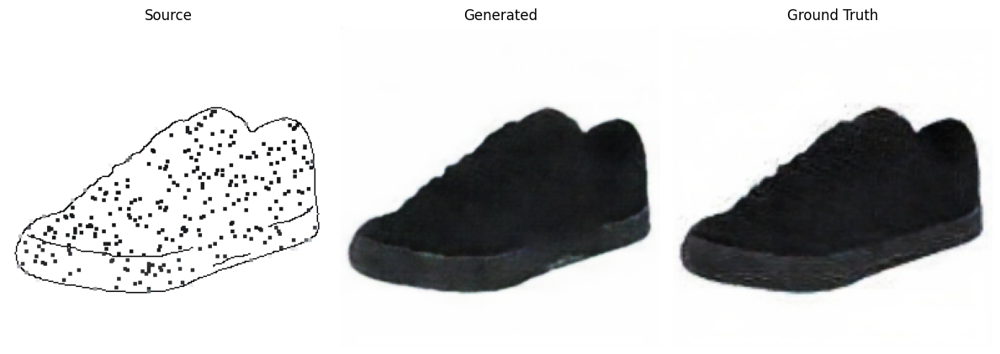

EPOCH: 18.000  d_loss: 0.504  g_loss: 4.099  (2917.15s - 1944.77s remaining)


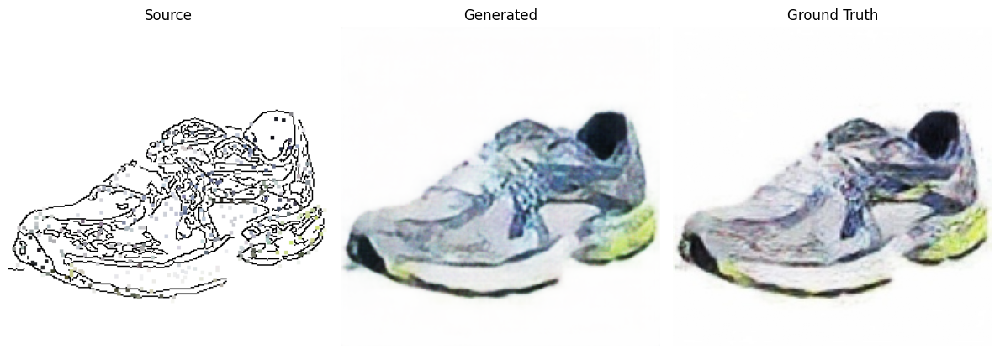

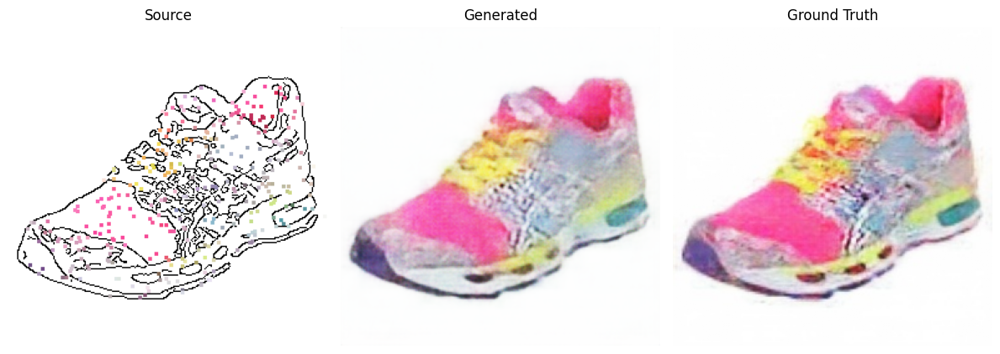

EPOCH: 19.000  d_loss: 0.508  g_loss: 4.068  (3082.69s - 1784.72s remaining)


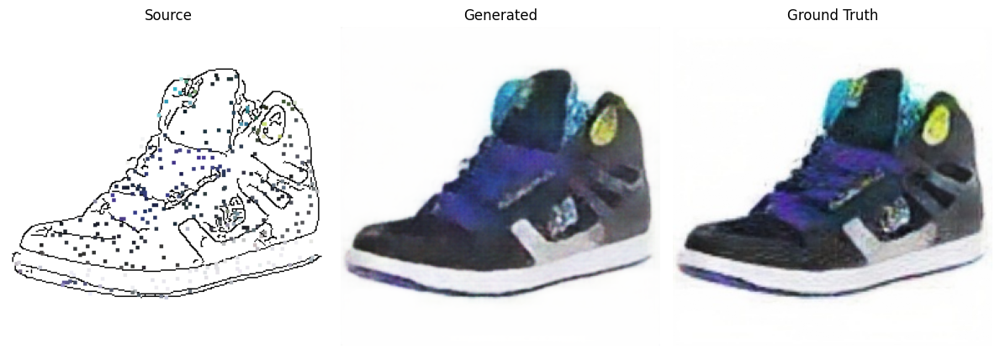

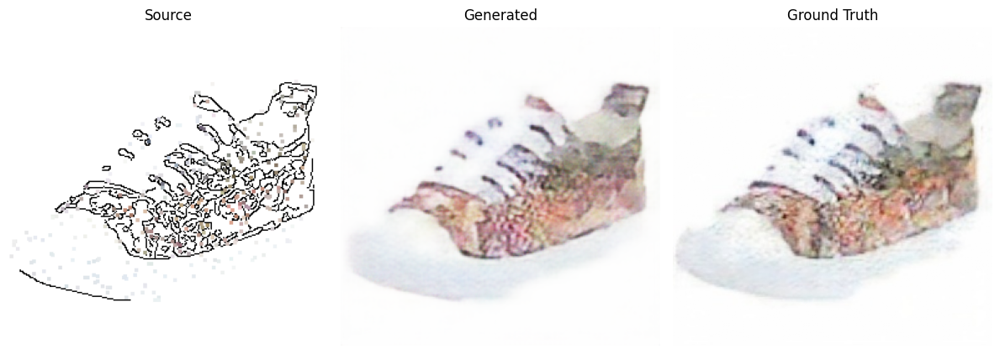

EPOCH: 20.000  d_loss: 0.509  g_loss: 3.994  (3248.70s - 1624.35s remaining)


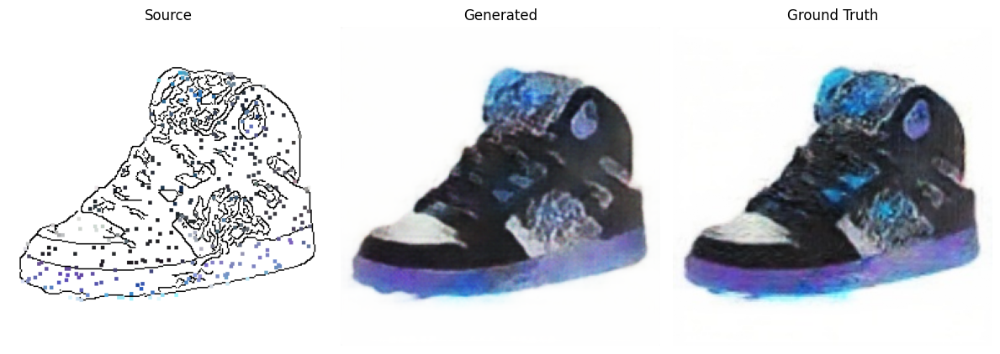

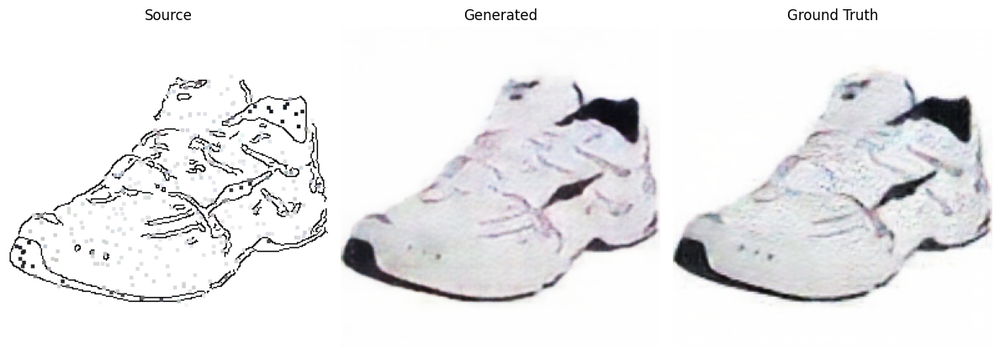

EPOCH: 21.000  d_loss: 0.501  g_loss: 3.909  (3415.61s - 1463.83s remaining)


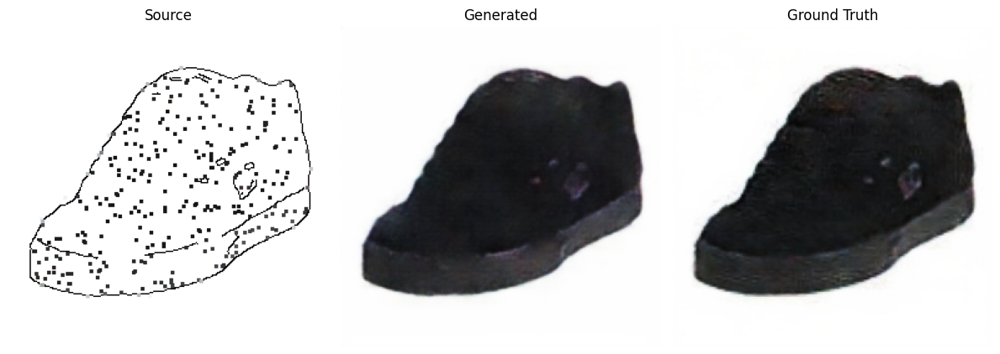

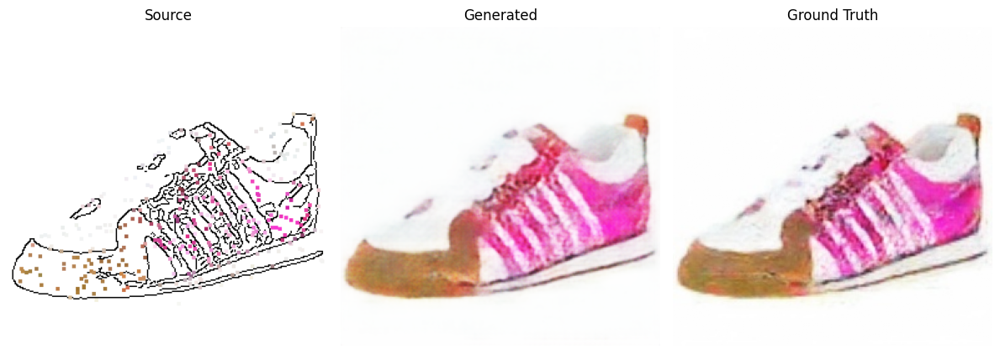

EPOCH: 22.000  d_loss: 0.501  g_loss: 3.953  (3582.51s - 1302.73s remaining)


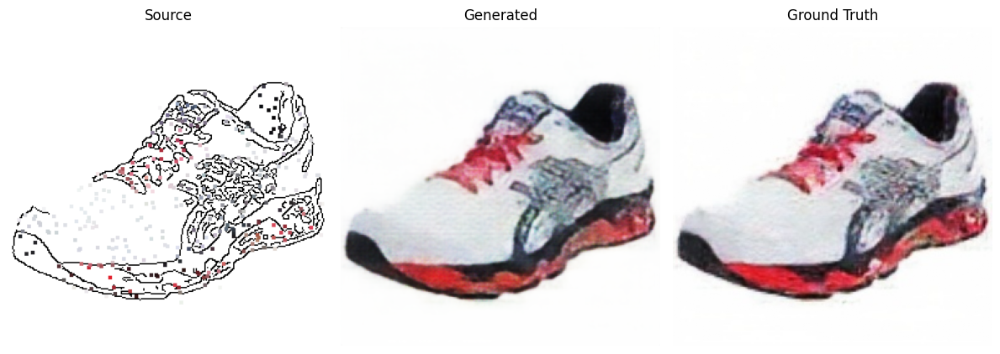

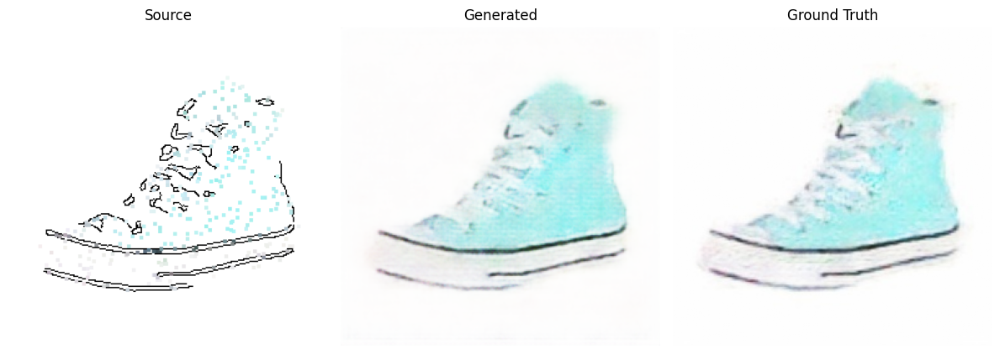

EPOCH: 23.000  d_loss: 0.531  g_loss: 3.815  (3749.54s - 1141.16s remaining)


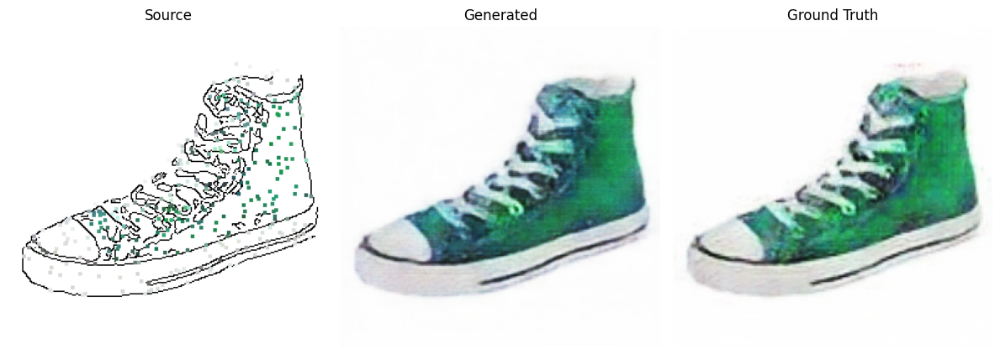

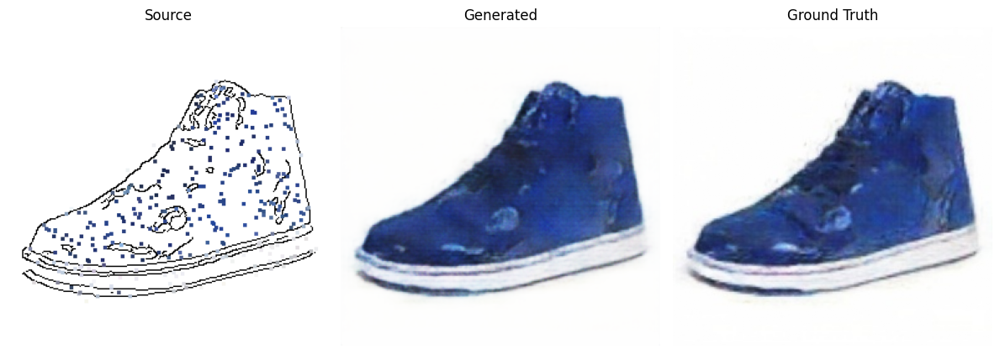

EPOCH: 24.000  d_loss: 0.489  g_loss: 3.880  (3917.20s - 979.30s remaining)


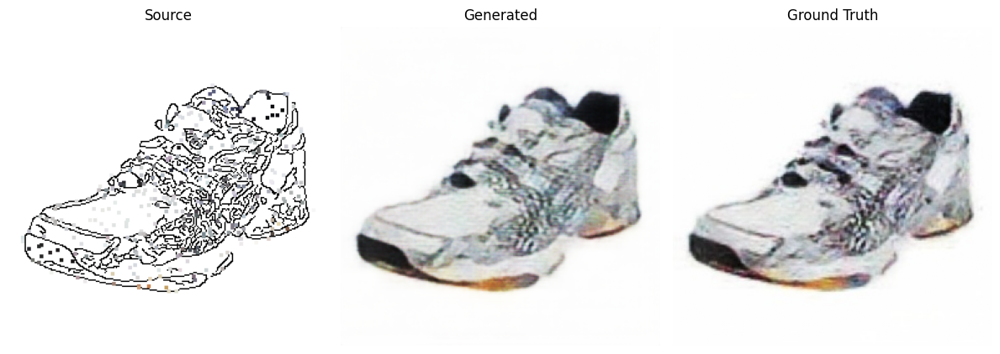

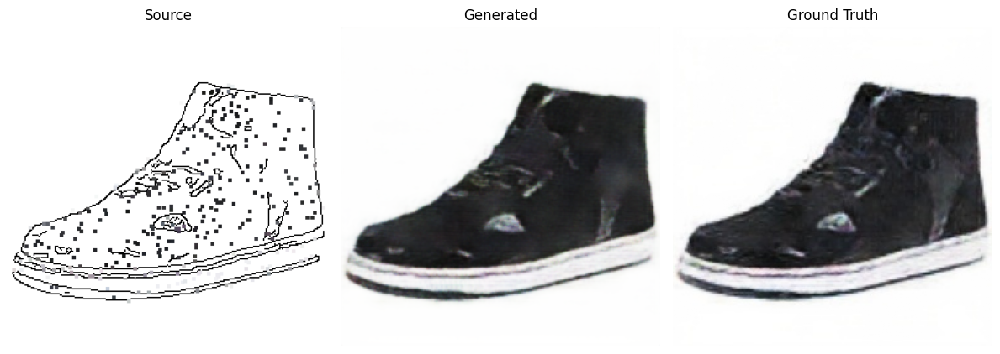

EPOCH: 25.000  d_loss: 0.495  g_loss: 3.822  (4085.40s - 817.08s remaining)


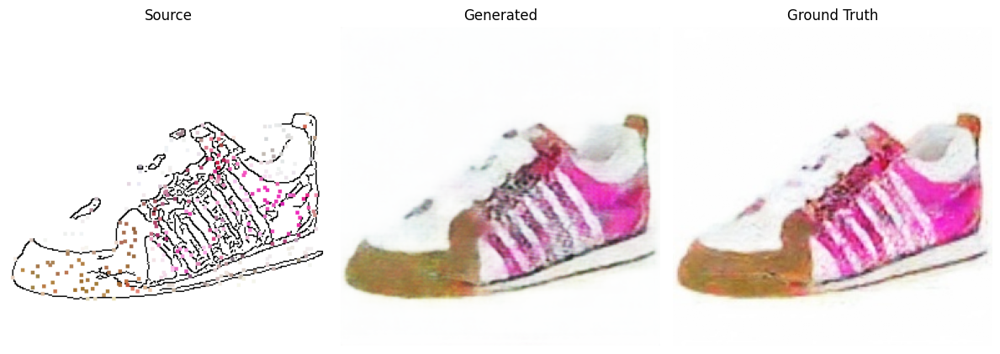

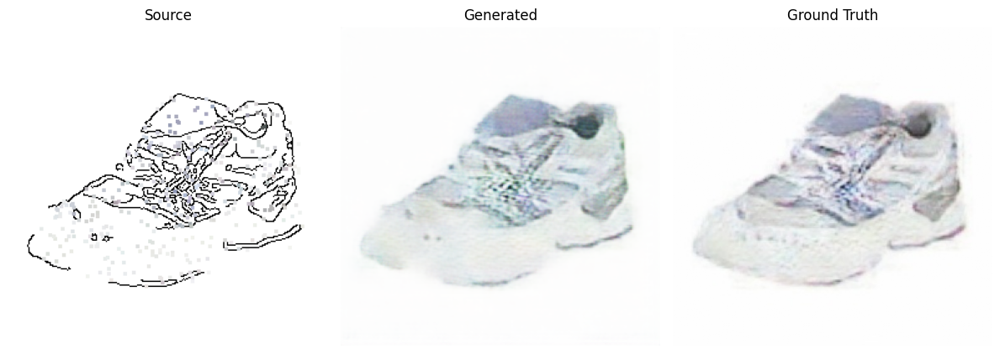

EPOCH: 26.000  d_loss: 0.522  g_loss: 3.790  (4254.55s - 654.55s remaining)


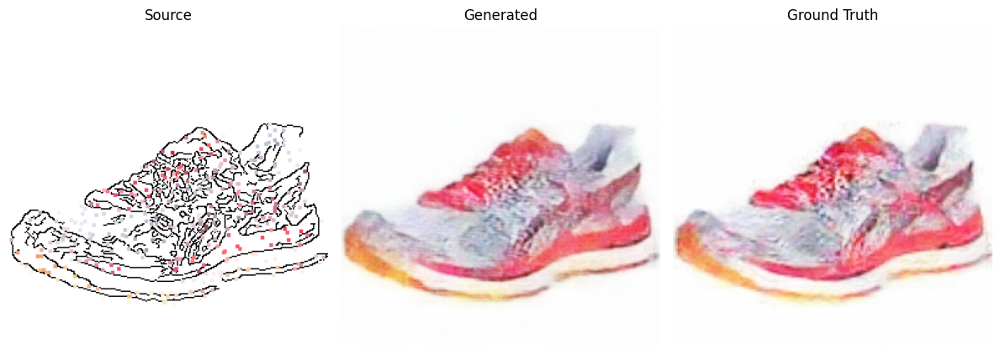

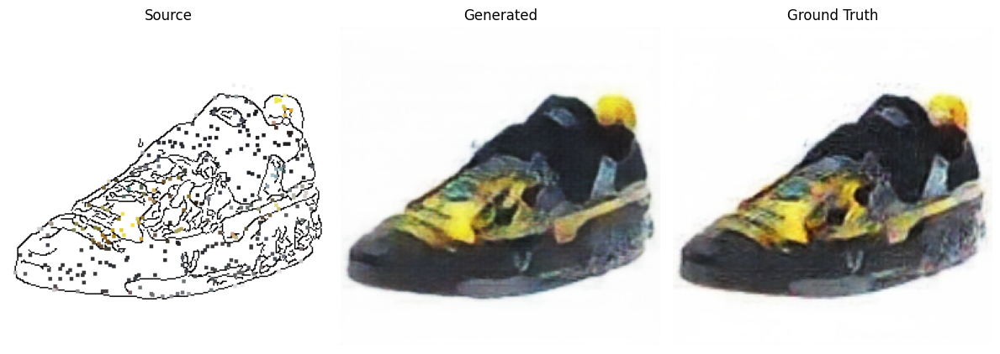

EPOCH: 27.000  d_loss: 0.478  g_loss: 3.747  (4423.29s - 491.48s remaining)


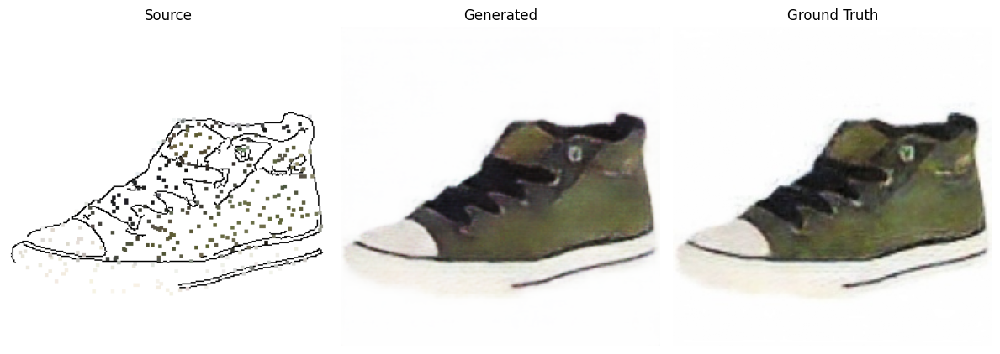

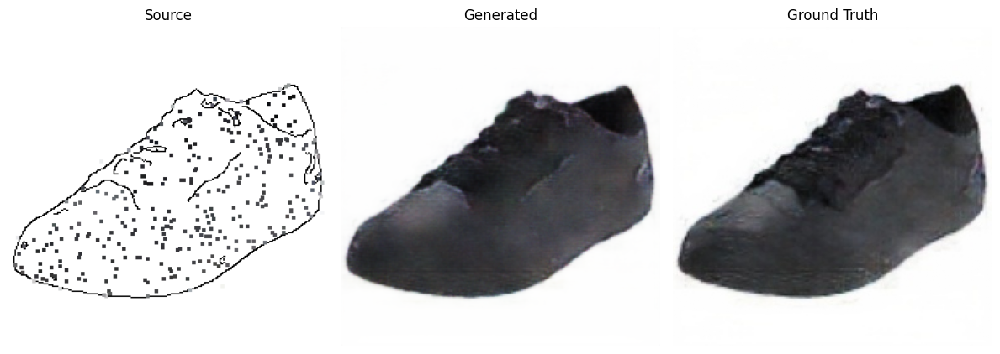

EPOCH: 28.000  d_loss: 0.488  g_loss: 3.738  (4591.77s - 327.98s remaining)


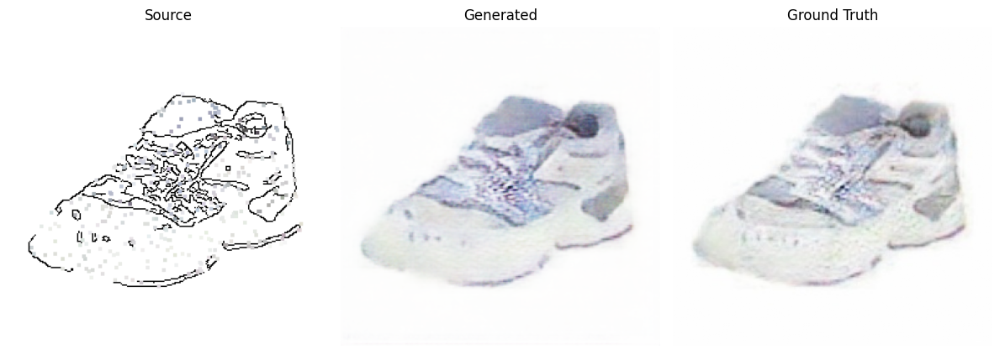

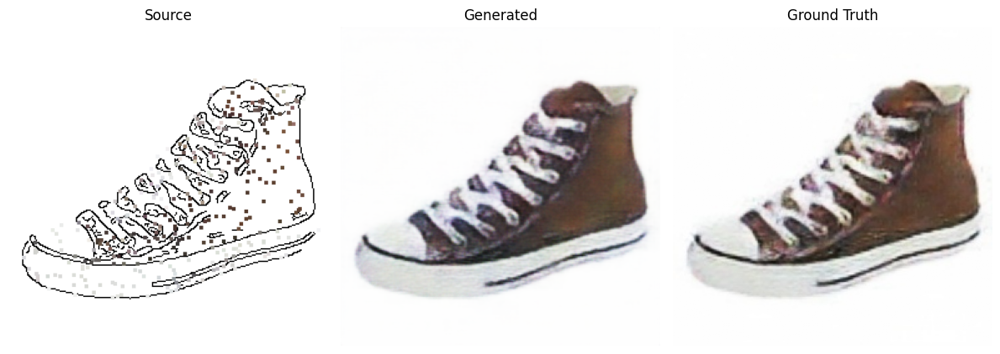

EPOCH: 29.000  d_loss: 0.489  g_loss: 3.694  (4761.29s - 164.18s remaining)


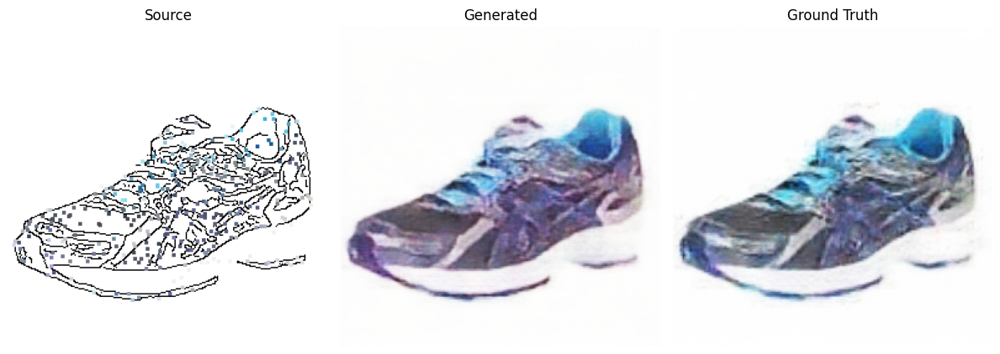

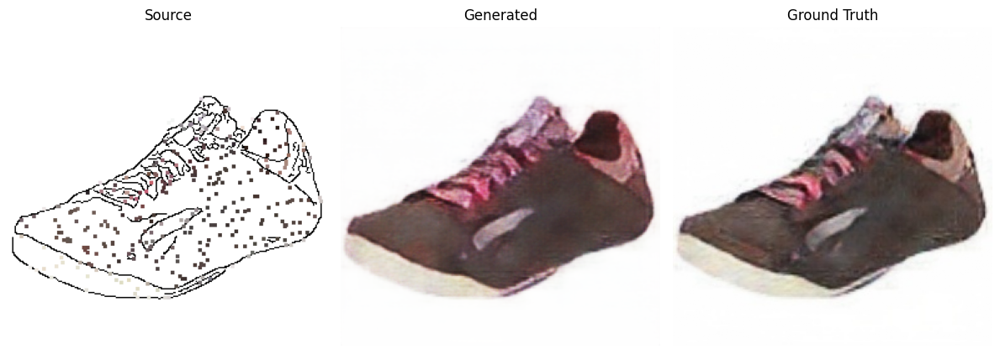

EPOCH: 30.000  d_loss: 0.483  g_loss: 3.668  (4929.96s - 0.00s remaining)


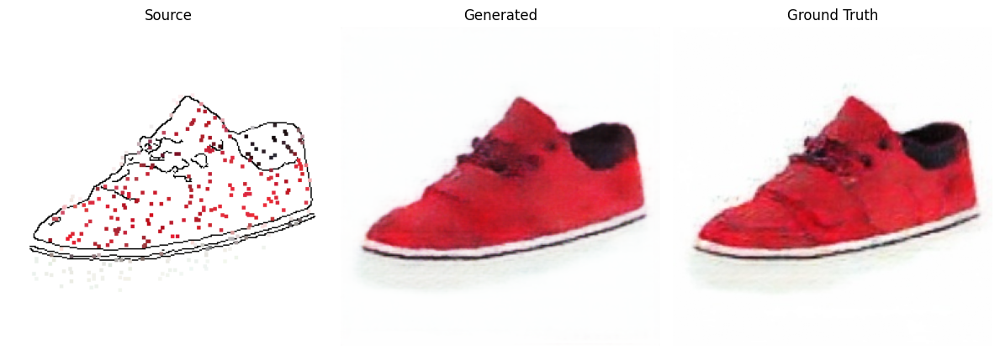

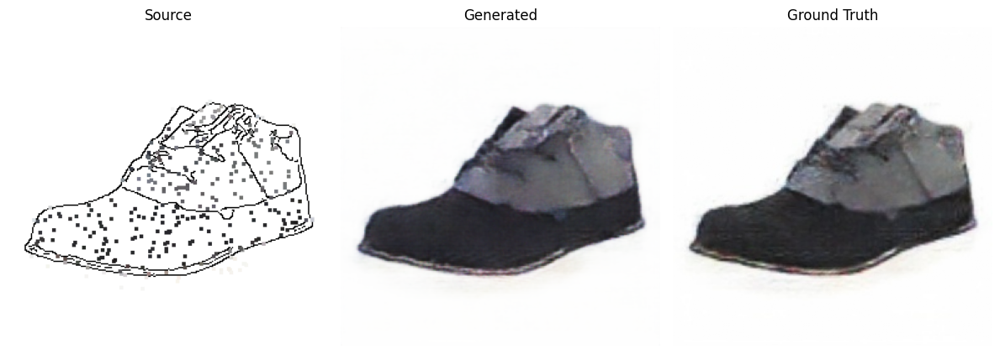

100%|██████████| 131/131 [00:00<00:00, 367.73it/s]


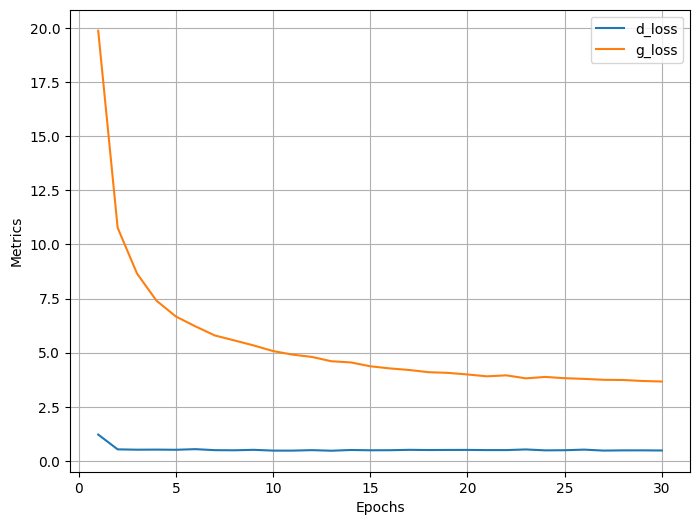

In [70]:
# Train the model
generator = GeneratorUNet().to(device)
discriminator = Discriminator().to(device)
generator.apply(weights_init_normal)
discriminator.apply(weights_init_normal)
criterion_GAN = nn.MSELoss()
criterion_pixelwise = nn.L1Loss()
g_optimizer = optim.Adam(generator.parameters(), lr=2e-4, betas=(0.5, 0.999))
d_optimizer = optim.Adam(discriminator.parameters(), lr=2e-4, betas=(0.5, 0.999))
train_dl, val_dl = load_data()
n_epochs = 30
log = Report(n_epochs)

for epoch in range(n_epochs):
    n = len(train_dl)
    for i, (real_src, real_target) in enumerate(train_dl):
        fake_target = generator(real_src)
        d_loss = train_discriminator(discriminator, (real_src, real_target, fake_target), criterion_GAN, d_optimizer)
        g_loss = train_generator(discriminator, (real_src, real_target, fake_target), (criterion_GAN, criterion_pixelwise), g_optimizer)
        log.record(epoch+(i+1)/n, d_loss=d_loss.item(), g_loss=g_loss.item(), end='\r')

    # Log the average loss for the epoch
    log.report_avgs(epoch+1)

    # Plot the generated images
    [sample_prediction(val_dl, generator) for _ in range(2)]

# Plot the loss
log.plot_epochs(['d_loss', 'g_loss'])

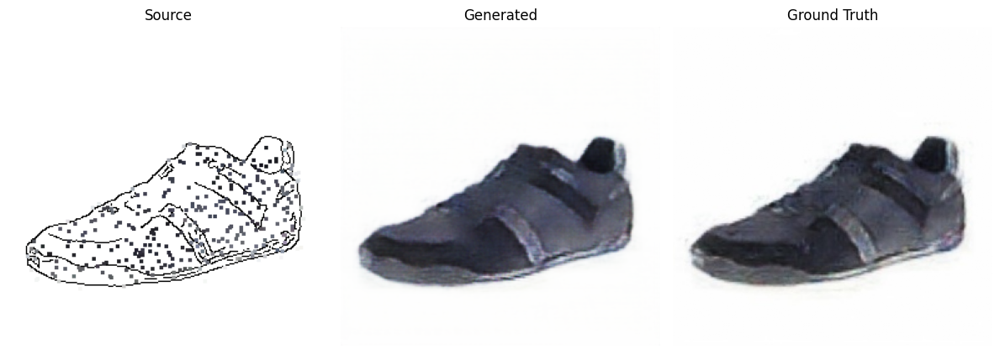

In [71]:
# Save model
torch.save(generator.state_dict(), 'generator.pth')
torch.save(discriminator.state_dict(), 'discriminator.pth')

# Load model
generator = GeneratorUNet().to(device)
generator.load_state_dict(torch.load('generator.pth'))
generator.eval()

# Generate images
sample_prediction(val_dl, generator)

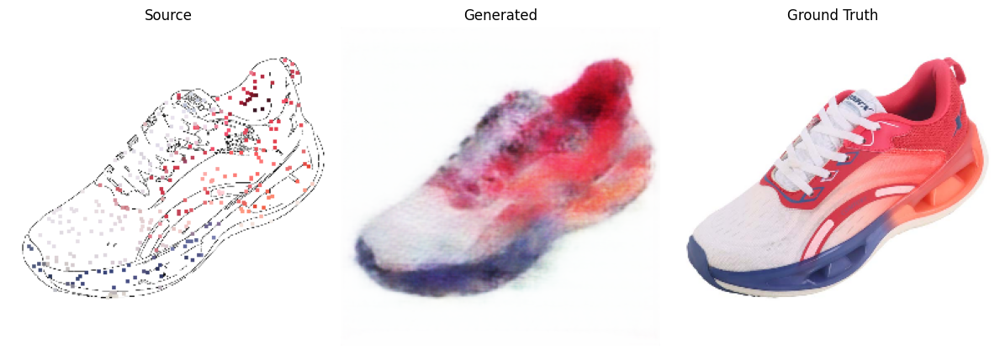

In [85]:
# Predict on a custom image
!wget 'https://dxkvlfvncvqr8.cloudfront.net/media/product-image/SL-259-WHRC-1.jpg' -q -O shoe.jpg
shoe = cv2.imread('shoe.jpg')

# Use Dataset class to preprocess the image
ds = ShoesData(['shoe.jpg'])
dl = DataLoader(ds, batch_size=1, shuffle=False)

# Plot the generated image from the custom image
sample_prediction(dl, generator)